## Import libraries

In [120]:
#import libraries
import numpy as np
import pandas as pd
import tensorflow as tf
import matplotlib.pyplot as plt
from skimage.transform import resize
from keras.utils.vis_utils import plot_model
import imageio
import glob
import os

In [163]:
!pip install git+https://github.com/tensorflow/docs

  Cloning https://github.com/tensorflow/docs to /tmp/pip-req-build-43udm7dg
  Running command git clone -q https://github.com/tensorflow/docs /tmp/pip-req-build-43udm7dg
  Resolved https://github.com/tensorflow/docs to commit 44a3c7bafb44232d25a1e42a6be686ad4c6b67c7
     |████████████████████████████████| 661 kB 776 kB/s eta 0:00:01
  Created wheel for tensorflow-docs: filename=tensorflow_docs-0.0.0.dev0-py3-none-any.whl size=175822 sha256=92524184b4a8a198f45486a34804e9308e5436f909740c1c8f52bcc873aa86c4
  Stored in directory: /tmp/pip-ephem-wheel-cache-e3fgvmfr/wheels/fc/f8/3b/5d21409a59cb1be9b1ade11f682039ced75b84de9dd6a0c8de
Successfully built tensorflow-docs


In [165]:
# Verify if GPU is set as the default device for training
# tf.compat.v1.Session(config=tf.compat.v1.ConfigProto(log_device_placement=True))

## Data preparation

In [121]:
#data set paths
t1_dataset_path = 'MRI+T1_T2+Dataset/Tr1/TrainT1'
t2_dataset_path = 'MRI+T1_T2+Dataset/Tr2/TrainT2'

In [122]:
#get the list of files in the above paths
t1_name_list = os.listdir(t1_dataset_path)
t2_name_list = os.listdir(t2_dataset_path)

In [123]:
#create t1 dataset
images = []
for image_name in t1_name_list:
    image = imageio.imread(t1_dataset_path+'/'+image_name)
    images.append(image)
t1_dataset = np.asarray(images)

In [124]:
#create t2 dataset
images = []
for image_name in t2_name_list:
    image = imageio.imread(t2_dataset_path+'/'+image_name)
    images.append(image)
t2_dataset = np.asarray(images)

In [125]:
t1_dataset.shape

(43, 217, 181)

In [126]:
t2_dataset.shape

(46, 217, 181)

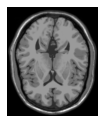

In [127]:
#visualize an image belonging to t1 dataset
plt.figure(figsize=(2,2))
plt.imshow(t1_dataset[1], cmap='gray')
plt.axis('off')
plt.show()

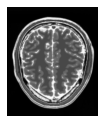

In [128]:
#visualize an image belonging to t2 dataset
plt.figure(figsize=(2,2))
plt.imshow(t2_dataset[1], cmap='gray')
plt.axis('off')
plt.show()

In [129]:
#Normalize the images to the range [-1.0, 1.0]
t1_dataset = (t1_dataset/127.5)-1.0 
t2_dataset = (t2_dataset/127.5)-1.0

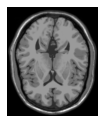

In [130]:
#visualize an image belonging to t1 dataset
plt.figure(figsize=(2,2))
plt.imshow(t1_dataset[1], cmap='gray')
plt.axis('off')
plt.show()

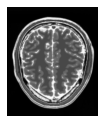

In [131]:
#visualize an image belonging to t2 dataset
plt.figure(figsize=(2,2))
plt.imshow(t2_dataset[1], cmap='gray')
plt.axis('off')
plt.show()

## Data Preprocessing

In [132]:
#using lower batch size since there are low number of images.
BATCH_SIZE = 1

#### Data Resizing

In [133]:
#resize images to 128x128
t1_data = np.zeros((t1_dataset.shape[0], 128, 128))
for index, img in enumerate(t1_dataset):
    t1_data[index, :, :] = resize(img, (128, 128))
t1_data.shape

(43, 128, 128)

In [134]:
t2_data = np.zeros((t2_dataset.shape[0], 128, 128))
for index, img in enumerate(t2_dataset):
    t2_data[index, :, :] = resize(img, (128, 128))
t2_data.shape

(46, 128, 128)

#### Data reshaping

In [135]:
#reshape to tensor format
t1_data = t1_data.reshape(t1_data.shape[0], 128, 128, 1).astype('float32')
t2_data = t2_data.reshape(t2_data.shape[0], 128, 128, 1).astype('float32')

#### Batch and Shuffle Data

In [136]:
t1_data = tf.data.Dataset.from_tensor_slices(t1_data).shuffle(t1_dataset.shape[0], seed=42).batch(BATCH_SIZE)
t2_data = tf.data.Dataset.from_tensor_slices(t2_data).shuffle(t2_dataset.shape[0], seed=42).batch(BATCH_SIZE)

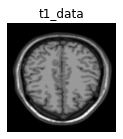

In [137]:
sample_t1_data = next(iter(t1_data))
plt.figure(figsize=(2, 2))
plt.imshow(sample_t1_data[0].numpy()[:, :, 0], cmap='gray')
plt.title('t1_data')
plt.axis('off')
plt.show()

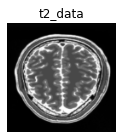

In [138]:
sample_t2_data = next(iter(t2_data))
plt.figure(figsize=(2, 2))
plt.imshow(sample_t2_data[0].numpy()[:, :, 0], cmap='gray')
plt.title('t2_data')
plt.axis('off')
plt.show()

## Model Building

#### Instance normalization


In [139]:
#Instance Normalization are specially used with Style Transfer, 
#where Separate Normalization is performed for each sample we 
#perform channelwise Normalization.
class InstanceNormalization(tf.keras.layers.Layer):
    # Initialization of Objects
    def __init__(self, epsilon=1e-5):
        # calling parent's init
        super(InstanceNormalization, self).__init__()
        self.epsilon = epsilon
    
    def build(self, input_shape):
        self.scale = self.add_weight(
            name='scale',
            shape=input_shape[-1:],
            initializer=tf.random_normal_initializer(1., 0.02),
            trainable=True)
        self.offset = self.add_weight(
            name='offset',
            shape=input_shape[-1:],
            initializer='zeros',
            trainable=True)
    
    def call(self, x):
        # Compute Mean and Variance, Axes=[1,2] ensures Instance Normalization
        mean, variance = tf.nn.moments(x, axes=[1, 2], keepdims=True)
        inv = tf.math.rsqrt(variance + self.epsilon)
        normalized = (x - mean) * inv
        return self.scale * normalized + self.offset

#### Downsampling

In [140]:
#Downsampling is performed using the Convolution, leading to reduce in dimensions.
def downsample(filters, size, apply_norm=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    # Add Conv2d layer
    result.add(tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                                      kernel_initializer=initializer, use_bias=False))
    # Add Normalization layer
    if apply_norm:
        result.add(InstanceNormalization())
    # Add Leaky Relu Activation
    result.add(tf.keras.layers.LeakyReLU())
    return result

#### Upsampling

In [141]:
#Upsampling is a result of Transposed Convolution, where dimension of image are increased.
def upsample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    # Add Transposed Conv2d layer
    result.add(tf.keras.layers.Conv2DTranspose(filters, size, strides=2, padding='same',
                                               kernel_initializer=initializer, use_bias=False))
    # Add Normalization Layer
    result.add(InstanceNormalization())
    # Conditionally add Dropout layer
    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))
    # Add Relu Activation Layer
    result.add(tf.keras.layers.ReLU())
    return result

#### Unets

In [142]:
# Unet Generator is a combination of Convolution + Transposed Convolution Layers
def unet_generator():
    down_stack = [
        downsample(256, 4, False),
        downsample(512, 4),
        downsample(512, 4),
        downsample(512, 4),
        downsample(512, 4) 
    ]
    up_stack = [
        upsample(512, 4, True), 
        upsample(512, 4, True), 
        upsample(512, 4), 
        upsample(256, 4) 
    ]
    initializer = tf.random_normal_initializer(0., 0.02)
    last = tf.keras.layers.Conv2DTranspose(1, 4, strides=2, padding='same', kernel_initializer=initializer,
                                           activation='tanh') # (bs, 32, 32, 1)
    concat = tf.keras.layers.Concatenate()
    inputs = tf.keras.layers.Input(shape=[128, 128, 1])
    x = inputs
    # Downsampling through the model
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)
    
    skips = reversed(skips[:-1])
    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = concat([x, skip])
    x = last(x)
    return tf.keras.Model(inputs=inputs, outputs=x)

#### Generator

In [143]:
#generators are unet networks here that translate one image to another
generator_g = unet_generator()
generator_f = unet_generator()

In [144]:
generator_g.summary()

Model: "model_12"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_7 (InputLayer)            [(None, 128, 128, 1) 0                                            
__________________________________________________________________________________________________
sequential_66 (Sequential)      (None, 64, 64, 256)  4096        input_7[0][0]                    
__________________________________________________________________________________________________
sequential_67 (Sequential)      (None, 32, 32, 512)  2098176     sequential_66[0][0]              
__________________________________________________________________________________________________
sequential_68 (Sequential)      (None, 16, 16, 512)  4195328     sequential_67[0][0]              
___________________________________________________________________________________________

#### Discriminator

In [145]:
# Discriminators only contain Convolutional Layers and no Transposed Convolution is not used 
def discriminator():
    initializer = tf.random_normal_initializer(0., 0.02)
    # add input layer of size (32, 32, 1)
    inp = tf.keras.layers.Input(shape=[128, 128, 1], name='input_image')
    x = inp
    
    # add downsampling step here
    down1 = downsample(256, 4, False)(x) 
    down2 = downsample(512, 4)(down1) 
    # add a padding layer here
    zero_pad1 = tf.keras.layers.ZeroPadding2D()(down2) 
    
    # implement a concrete downsampling layer here
    conv = tf.keras.layers.Conv2D(1024, 4, strides=1, kernel_initializer=initializer,
                                  use_bias=False)(zero_pad1) 
    norm1 = InstanceNormalization()(conv)
    leaky_relu = tf.keras.layers.LeakyReLU()(norm1)
    
    # apply zero padding layer
    zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu) 
    
    # add a last pure 2D Convolution layer
    last = tf.keras.layers.Conv2D(1, 4, strides=1, kernel_initializer=initializer)(zero_pad2) # (bs, 6, 6, 1)
    return tf.keras.Model(inputs=inp, outputs=last)

In [146]:
discriminator_x = discriminator()
discriminator_y = discriminator()

In [147]:
discriminator_x.summary()

Model: "model_14"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_image (InputLayer)     [(None, 128, 128, 1)]     0         
_________________________________________________________________
sequential_84 (Sequential)   (None, 64, 64, 256)       4096      
_________________________________________________________________
sequential_85 (Sequential)   (None, 32, 32, 512)       2098176   
_________________________________________________________________
zero_padding2d_12 (ZeroPaddi (None, 34, 34, 512)       0         
_________________________________________________________________
conv2d_66 (Conv2D)           (None, 31, 31, 1024)      8388608   
_________________________________________________________________
instance_normalization_77 (I (None, 31, 31, 1024)      2048      
_________________________________________________________________
leaky_re_lu_60 (LeakyReLU)   (None, 31, 31, 1024)      0  

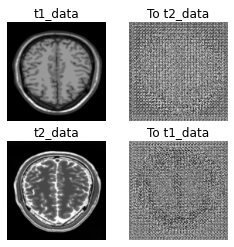

In [148]:
#untrained generator models
to_t2_data = generator_g(sample_t1_data)
to_t1_data = generator_f(sample_t2_data)
plt.figure(figsize=(4, 4))

imgs = [sample_t1_data, to_t2_data, sample_t2_data, to_t1_data]
title = ['t1_data', 'To t2_data', 't2_data', 'To t1_data']

for i in range(len(imgs)):
    plt.subplot(2, 2, i+1)
    plt.title(title[i])
    plt.imshow(imgs[i][0].numpy()[:, :, 0], cmap='gray')
    plt.axis('off')
plt.show()

In [149]:
#Declare loss as binary cross entropy
loss_obj = tf.keras.losses.BinaryCrossentropy(from_logits=True)

#### Discriminator Loss

In [150]:
def discriminator_loss(real, generated):
    real_loss = loss_obj(tf.ones_like(real), real)
    generated_loss = loss_obj(tf.zeros_like(generated), generated)
    total_disc_loss = real_loss + generated_loss
    return total_disc_loss * 0.5 # mean of losses

#### Generator Loss

In [151]:
def generator_loss(generated):
    return loss_obj(tf.ones_like(generated), generated)

#### Cycle loss

In [152]:
def calc_cycle_loss(real_image, cycled_image):
    loss1 = tf.reduce_mean(tf.abs(real_image - cycled_image))
    return 10.0 * loss1

#### Identity loss

In [153]:
def identity_loss(real_image, same_image):
    loss = tf.reduce_mean(tf.abs(real_image - same_image))
    return 0.5*loss

#### Optimizer

In [154]:
generator_g_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
generator_f_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

discriminator_x_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_y_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [155]:
EPOCHS = 200

#### Checkpoint initialization

In [156]:
checkpoint_path = "./Trained_Model"

ckpt = tf.train.Checkpoint(generator_g=generator_g,
                           generator_f=generator_f,
                           discriminator_x=discriminator_x,
                           discriminator_y=discriminator_y,
                           generator_g_optimizer=generator_g_optimizer,
                           generator_f_optimizer=generator_f_optimizer,
                           discriminator_x_optimizer=discriminator_x_optimizer,
                           discriminator_y_optimizer=discriminator_y_optimizer)

ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=3)

# if a checkpoint exists, restore the latest checkpoint.
if ckpt_manager.latest_checkpoint:
    ckpt.restore(ckpt_manager.latest_checkpoint)
    print ('Latest checkpoint restored!!')

In [157]:
#function to show generated outputs while training
def generate_images(model1, test_input1, model2, test_input2):
    prediction1 = model1(test_input1)
    prediction2 = model2(test_input2)
    plt.figure(figsize=(8, 4))
    display_list = [test_input1[0], prediction1[0], test_input2[0], prediction2[0]]
    title = ['Input Image', 'Predicted Image', 'Input Image', 'Predicted Image']
    for i in range(4):
        plt.subplot(1, 4, i+1)
        plt.title(title[i])
        plt.imshow(display_list[i].numpy()[:, :, 0], cmap='gray')
        plt.axis('off')

    plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
    plt.show()

#### Training Flow

Below Function performs one Flow of Batch Training

In [158]:
@tf.function
def train_step(real_x, real_y):
    # persistent is set to True because the tape is used more than
    # once to calculate the gradients.
    with tf.GradientTape(persistent=True) as tape:
        # Generator G translates X -> Y
        # Generator F translates Y -> X
        fake_y = generator_g(real_x, training=True)
        cycled_x = generator_f(fake_y, training=True)
        
        fake_x = generator_f(real_y, training=True)
        cycled_y = generator_g(fake_x, training=True)
        
        # same_x and same_y are used for identity loss.
        same_x = generator_f(real_x, training=True)
        same_y = generator_g(real_y, training=True)
        
        disc_real_x = discriminator_x(real_x, training=True)
        disc_real_y = discriminator_y(real_y, training=True)
        
        disc_fake_x = discriminator_x(fake_x, training=True)
        disc_fake_y = discriminator_y(fake_y, training=True)
        
        # calculate the loss
        gen_g_loss = generator_loss(disc_fake_y)
        gen_f_loss = generator_loss(disc_fake_x)
        
        total_cycle_loss = calc_cycle_loss(real_x, cycled_x) + calc_cycle_loss(real_y, cycled_y)
        
        # Total generator loss = BCE loss + cycle loss + identity loss
        total_gen_g_loss = gen_g_loss + total_cycle_loss + identity_loss(real_y, same_y)
        total_gen_f_loss = gen_f_loss + total_cycle_loss + identity_loss(real_x, same_x)
        
        # Discriminator's loss
        disc_x_loss = discriminator_loss(disc_real_x, disc_fake_x)
        disc_y_loss = discriminator_loss(disc_real_y, disc_fake_y)
        
    # Calculate the gradients for generator and discriminator
    generator_g_gradients = tape.gradient(total_gen_g_loss, generator_g.trainable_variables)
    generator_f_gradients = tape.gradient(total_gen_f_loss, generator_f.trainable_variables)
    
    discriminator_x_gradients = tape.gradient(disc_x_loss, discriminator_x.trainable_variables)
    discriminator_y_gradients = tape.gradient(disc_y_loss, discriminator_y.trainable_variables)
    
    # Apply the gradients to the optimizer
    generator_g_optimizer.apply_gradients(zip(generator_g_gradients, generator_g.trainable_variables))
    generator_f_optimizer.apply_gradients(zip(generator_f_gradients, generator_f.trainable_variables))
    
    discriminator_x_optimizer.apply_gradients(zip(discriminator_x_gradients, discriminator_x.trainable_variables))
    discriminator_y_optimizer.apply_gradients(zip(discriminator_y_gradients, discriminator_y.trainable_variables))

#### Train CycleGAN for several epochs

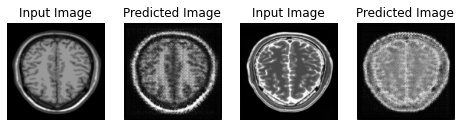

Saving checkpoint for epoch 1 at ./Trained_Model/ckpt-1


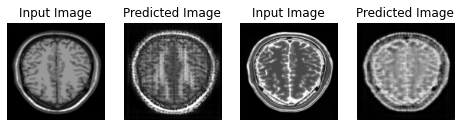

Saving checkpoint for epoch 2 at ./Trained_Model/ckpt-2


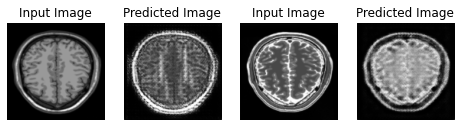

Saving checkpoint for epoch 3 at ./Trained_Model/ckpt-3


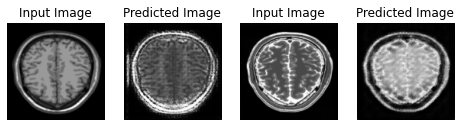

Saving checkpoint for epoch 4 at ./Trained_Model/ckpt-4


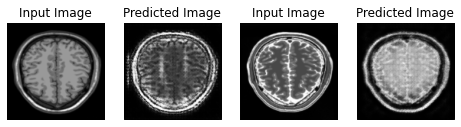

Saving checkpoint for epoch 5 at ./Trained_Model/ckpt-5


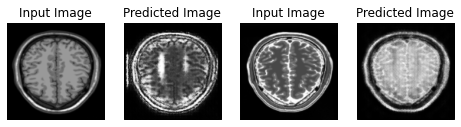

Saving checkpoint for epoch 6 at ./Trained_Model/ckpt-6


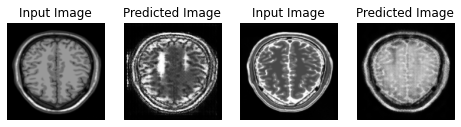

Saving checkpoint for epoch 7 at ./Trained_Model/ckpt-7


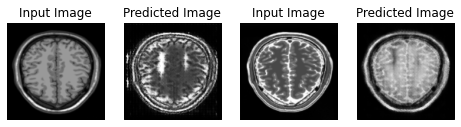

Saving checkpoint for epoch 8 at ./Trained_Model/ckpt-8


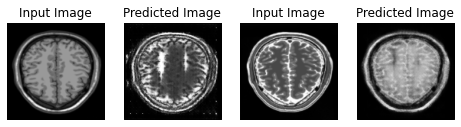

Saving checkpoint for epoch 9 at ./Trained_Model/ckpt-9


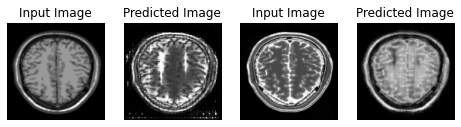

Saving checkpoint for epoch 10 at ./Trained_Model/ckpt-10


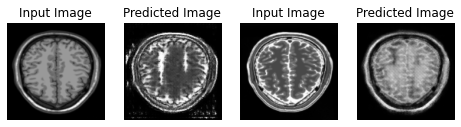

Saving checkpoint for epoch 11 at ./Trained_Model/ckpt-11


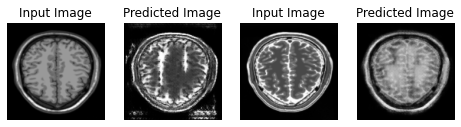

Saving checkpoint for epoch 12 at ./Trained_Model/ckpt-12


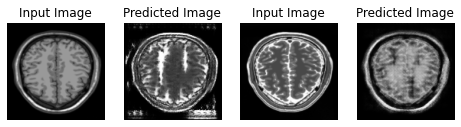

Saving checkpoint for epoch 13 at ./Trained_Model/ckpt-13


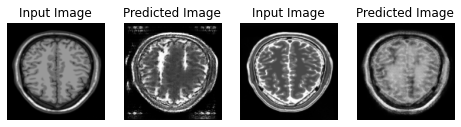

Saving checkpoint for epoch 14 at ./Trained_Model/ckpt-14


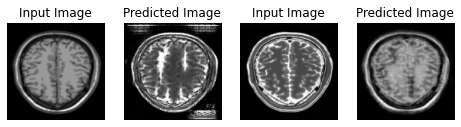

Saving checkpoint for epoch 15 at ./Trained_Model/ckpt-15


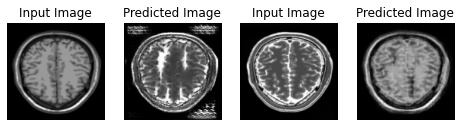

Saving checkpoint for epoch 16 at ./Trained_Model/ckpt-16


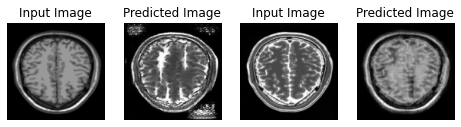

Saving checkpoint for epoch 17 at ./Trained_Model/ckpt-17


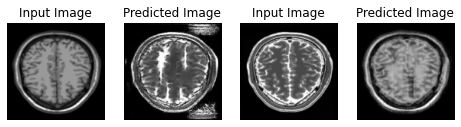

Saving checkpoint for epoch 18 at ./Trained_Model/ckpt-18


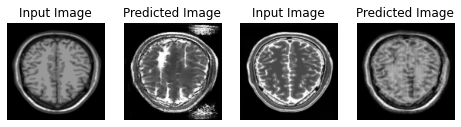

Saving checkpoint for epoch 19 at ./Trained_Model/ckpt-19


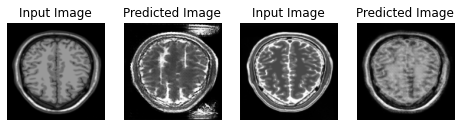

Saving checkpoint for epoch 20 at ./Trained_Model/ckpt-20


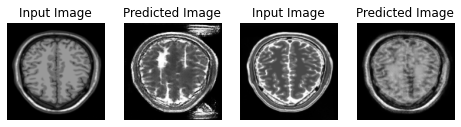

Saving checkpoint for epoch 21 at ./Trained_Model/ckpt-21


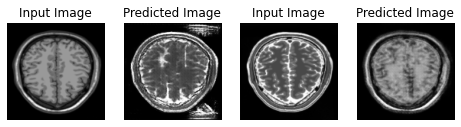

Saving checkpoint for epoch 22 at ./Trained_Model/ckpt-22


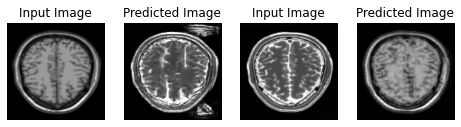

Saving checkpoint for epoch 23 at ./Trained_Model/ckpt-23


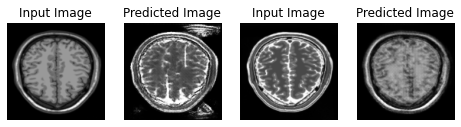

Saving checkpoint for epoch 24 at ./Trained_Model/ckpt-24


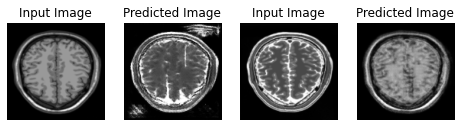

Saving checkpoint for epoch 25 at ./Trained_Model/ckpt-25


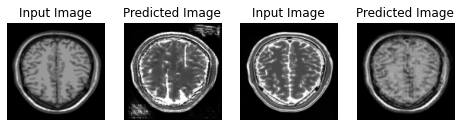

Saving checkpoint for epoch 26 at ./Trained_Model/ckpt-26


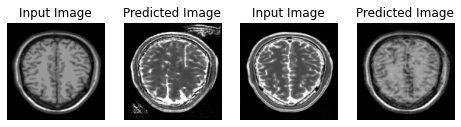

Saving checkpoint for epoch 27 at ./Trained_Model/ckpt-27


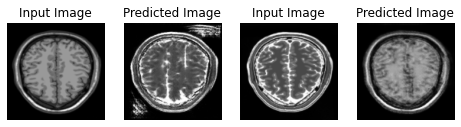

Saving checkpoint for epoch 28 at ./Trained_Model/ckpt-28


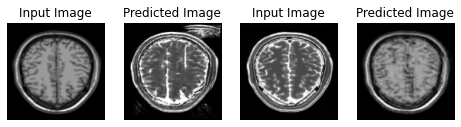

Saving checkpoint for epoch 29 at ./Trained_Model/ckpt-29


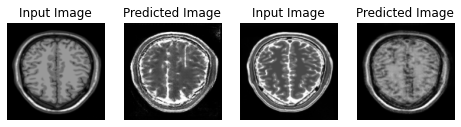

Saving checkpoint for epoch 30 at ./Trained_Model/ckpt-30


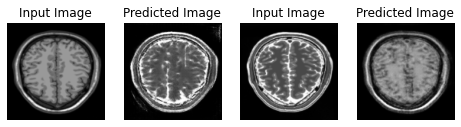

Saving checkpoint for epoch 31 at ./Trained_Model/ckpt-31


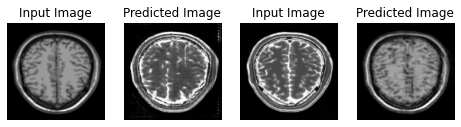

Saving checkpoint for epoch 32 at ./Trained_Model/ckpt-32


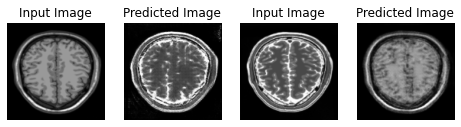

Saving checkpoint for epoch 33 at ./Trained_Model/ckpt-33


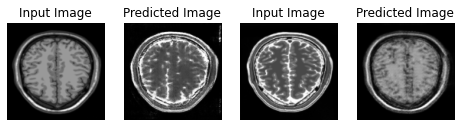

Saving checkpoint for epoch 34 at ./Trained_Model/ckpt-34


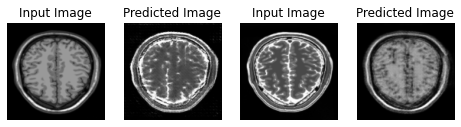

Saving checkpoint for epoch 35 at ./Trained_Model/ckpt-35


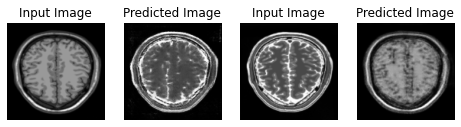

Saving checkpoint for epoch 36 at ./Trained_Model/ckpt-36


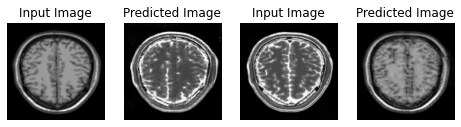

Saving checkpoint for epoch 37 at ./Trained_Model/ckpt-37


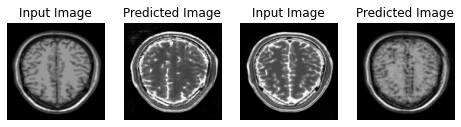

Saving checkpoint for epoch 38 at ./Trained_Model/ckpt-38


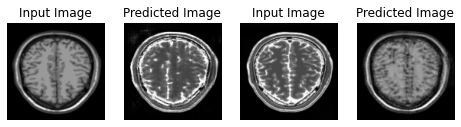

Saving checkpoint for epoch 39 at ./Trained_Model/ckpt-39


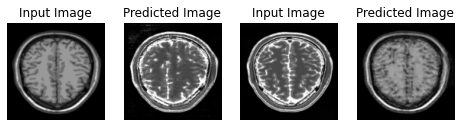

Saving checkpoint for epoch 40 at ./Trained_Model/ckpt-40


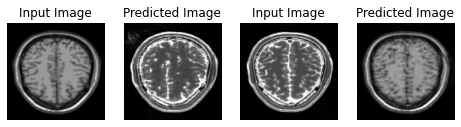

Saving checkpoint for epoch 41 at ./Trained_Model/ckpt-41


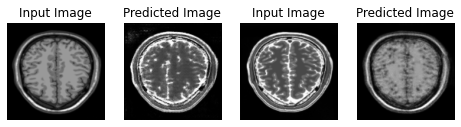

Saving checkpoint for epoch 42 at ./Trained_Model/ckpt-42


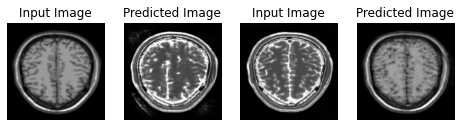

Saving checkpoint for epoch 43 at ./Trained_Model/ckpt-43


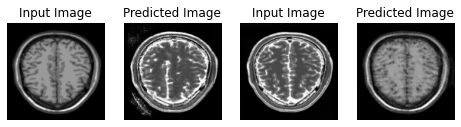

Saving checkpoint for epoch 44 at ./Trained_Model/ckpt-44


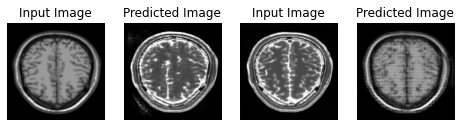

Saving checkpoint for epoch 45 at ./Trained_Model/ckpt-45


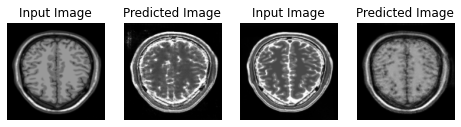

Saving checkpoint for epoch 46 at ./Trained_Model/ckpt-46


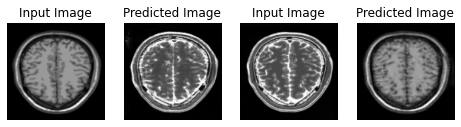

Saving checkpoint for epoch 47 at ./Trained_Model/ckpt-47


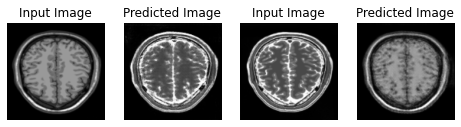

Saving checkpoint for epoch 48 at ./Trained_Model/ckpt-48


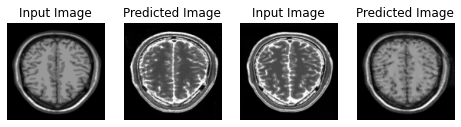

Saving checkpoint for epoch 49 at ./Trained_Model/ckpt-49


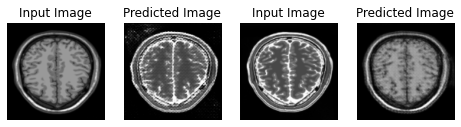

Saving checkpoint for epoch 50 at ./Trained_Model/ckpt-50


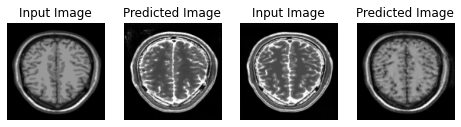

Saving checkpoint for epoch 51 at ./Trained_Model/ckpt-51


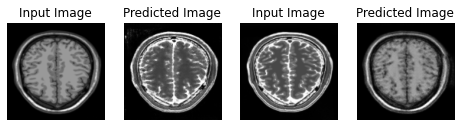

Saving checkpoint for epoch 52 at ./Trained_Model/ckpt-52


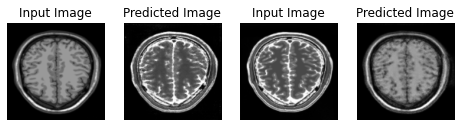

Saving checkpoint for epoch 53 at ./Trained_Model/ckpt-53


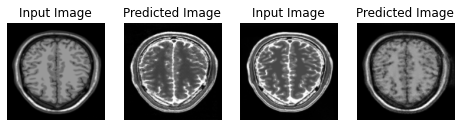

Saving checkpoint for epoch 54 at ./Trained_Model/ckpt-54


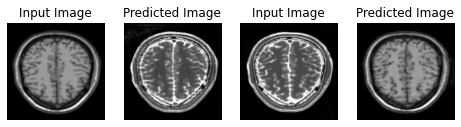

Saving checkpoint for epoch 55 at ./Trained_Model/ckpt-55


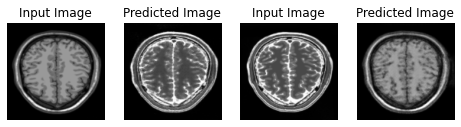

Saving checkpoint for epoch 56 at ./Trained_Model/ckpt-56


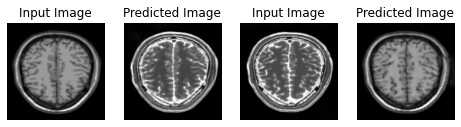

Saving checkpoint for epoch 57 at ./Trained_Model/ckpt-57


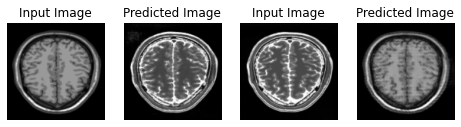

Saving checkpoint for epoch 58 at ./Trained_Model/ckpt-58


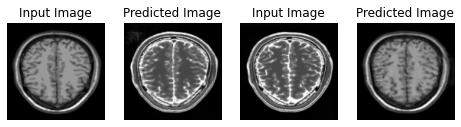

Saving checkpoint for epoch 59 at ./Trained_Model/ckpt-59


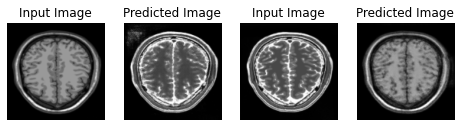

Saving checkpoint for epoch 60 at ./Trained_Model/ckpt-60


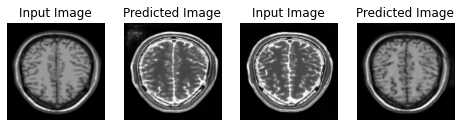

Saving checkpoint for epoch 61 at ./Trained_Model/ckpt-61


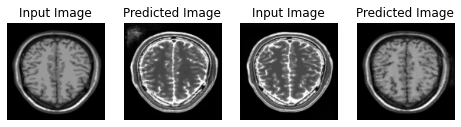

Saving checkpoint for epoch 62 at ./Trained_Model/ckpt-62


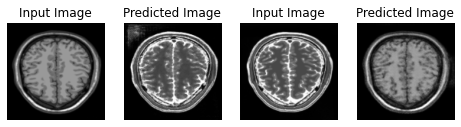

Saving checkpoint for epoch 63 at ./Trained_Model/ckpt-63


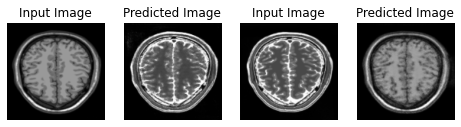

Saving checkpoint for epoch 64 at ./Trained_Model/ckpt-64


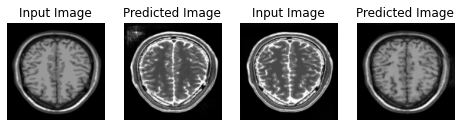

Saving checkpoint for epoch 65 at ./Trained_Model/ckpt-65


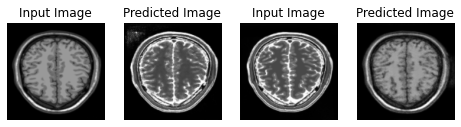

Saving checkpoint for epoch 66 at ./Trained_Model/ckpt-66


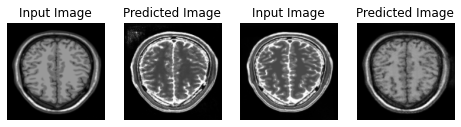

Saving checkpoint for epoch 67 at ./Trained_Model/ckpt-67


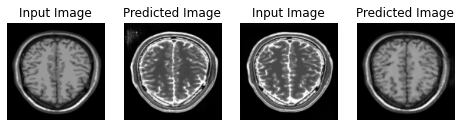

Saving checkpoint for epoch 68 at ./Trained_Model/ckpt-68


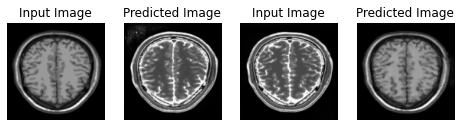

Saving checkpoint for epoch 69 at ./Trained_Model/ckpt-69


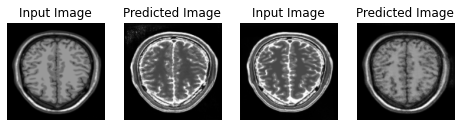

Saving checkpoint for epoch 70 at ./Trained_Model/ckpt-70


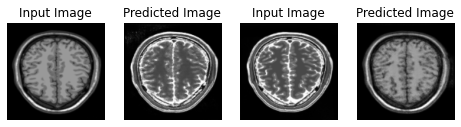

Saving checkpoint for epoch 71 at ./Trained_Model/ckpt-71


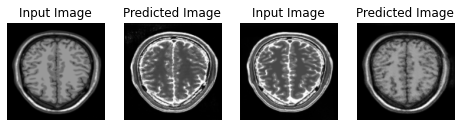

Saving checkpoint for epoch 72 at ./Trained_Model/ckpt-72


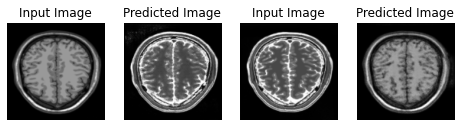

Saving checkpoint for epoch 73 at ./Trained_Model/ckpt-73


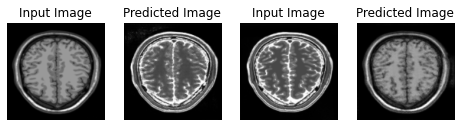

Saving checkpoint for epoch 74 at ./Trained_Model/ckpt-74


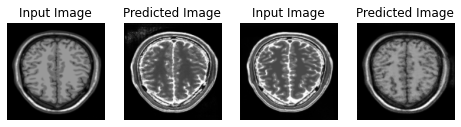

Saving checkpoint for epoch 75 at ./Trained_Model/ckpt-75


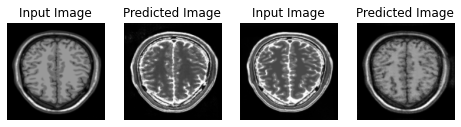

Saving checkpoint for epoch 76 at ./Trained_Model/ckpt-76


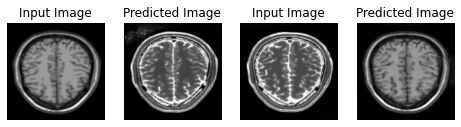

Saving checkpoint for epoch 77 at ./Trained_Model/ckpt-77


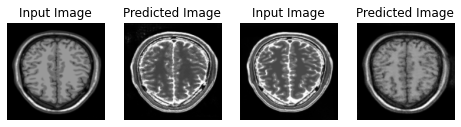

Saving checkpoint for epoch 78 at ./Trained_Model/ckpt-78


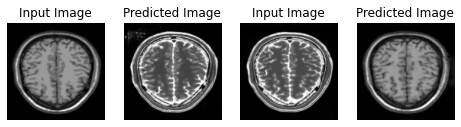

Saving checkpoint for epoch 79 at ./Trained_Model/ckpt-79


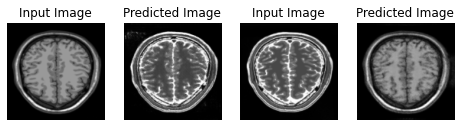

Saving checkpoint for epoch 80 at ./Trained_Model/ckpt-80


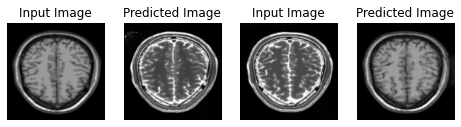

Saving checkpoint for epoch 81 at ./Trained_Model/ckpt-81


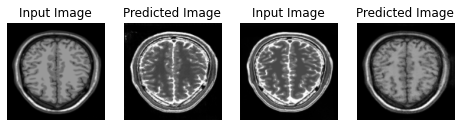

Saving checkpoint for epoch 82 at ./Trained_Model/ckpt-82


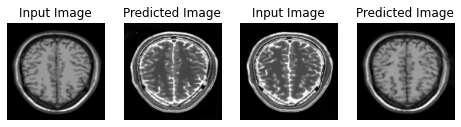

Saving checkpoint for epoch 83 at ./Trained_Model/ckpt-83


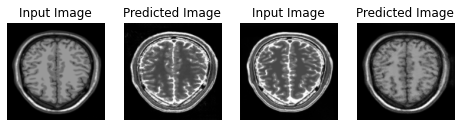

Saving checkpoint for epoch 84 at ./Trained_Model/ckpt-84


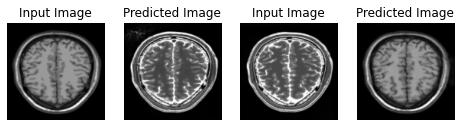

Saving checkpoint for epoch 85 at ./Trained_Model/ckpt-85


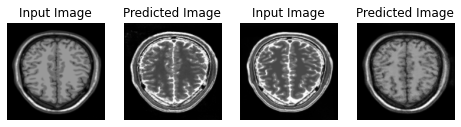

Saving checkpoint for epoch 86 at ./Trained_Model/ckpt-86


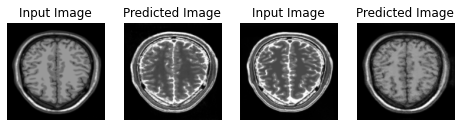

Saving checkpoint for epoch 87 at ./Trained_Model/ckpt-87


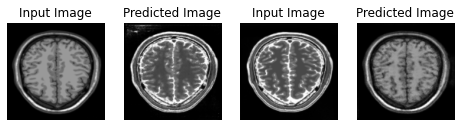

Saving checkpoint for epoch 88 at ./Trained_Model/ckpt-88


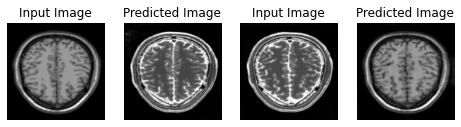

Saving checkpoint for epoch 89 at ./Trained_Model/ckpt-89


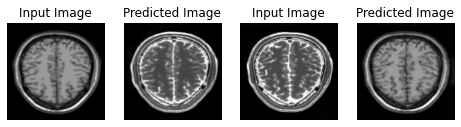

Saving checkpoint for epoch 90 at ./Trained_Model/ckpt-90


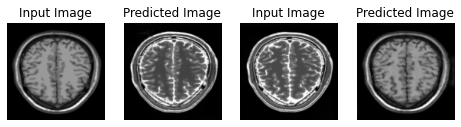

Saving checkpoint for epoch 91 at ./Trained_Model/ckpt-91


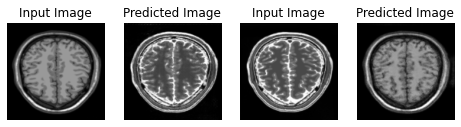

Saving checkpoint for epoch 92 at ./Trained_Model/ckpt-92


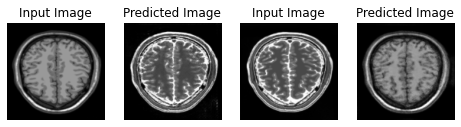

Saving checkpoint for epoch 93 at ./Trained_Model/ckpt-93


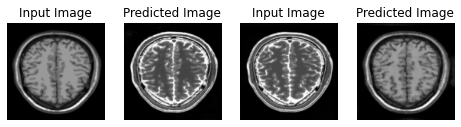

Saving checkpoint for epoch 94 at ./Trained_Model/ckpt-94


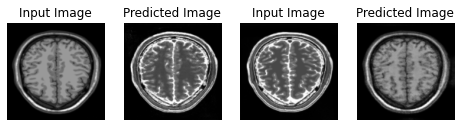

Saving checkpoint for epoch 95 at ./Trained_Model/ckpt-95


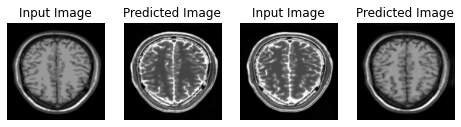

Saving checkpoint for epoch 96 at ./Trained_Model/ckpt-96


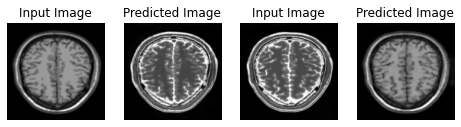

Saving checkpoint for epoch 97 at ./Trained_Model/ckpt-97


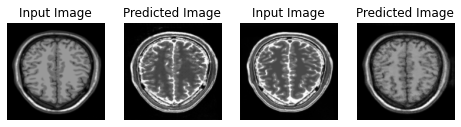

Saving checkpoint for epoch 98 at ./Trained_Model/ckpt-98


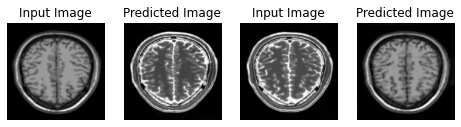

Saving checkpoint for epoch 99 at ./Trained_Model/ckpt-99


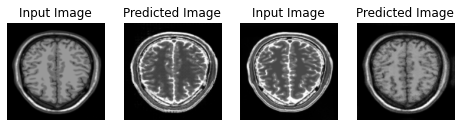

Saving checkpoint for epoch 100 at ./Trained_Model/ckpt-100


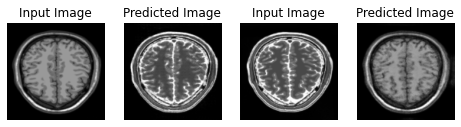

Saving checkpoint for epoch 101 at ./Trained_Model/ckpt-101


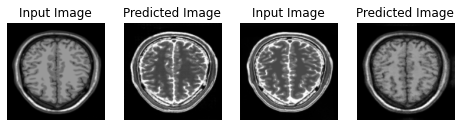

Saving checkpoint for epoch 102 at ./Trained_Model/ckpt-102


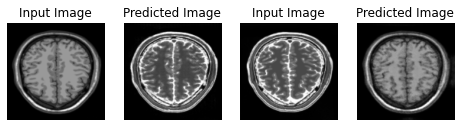

Saving checkpoint for epoch 103 at ./Trained_Model/ckpt-103


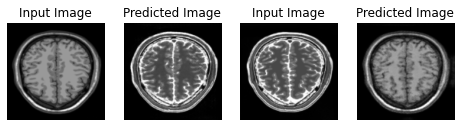

Saving checkpoint for epoch 104 at ./Trained_Model/ckpt-104


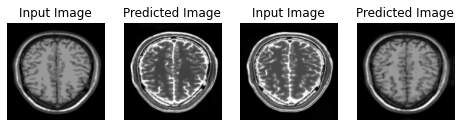

Saving checkpoint for epoch 105 at ./Trained_Model/ckpt-105


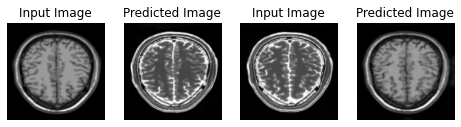

Saving checkpoint for epoch 106 at ./Trained_Model/ckpt-106


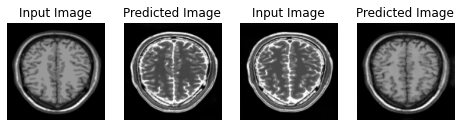

Saving checkpoint for epoch 107 at ./Trained_Model/ckpt-107


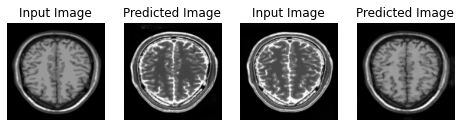

Saving checkpoint for epoch 108 at ./Trained_Model/ckpt-108


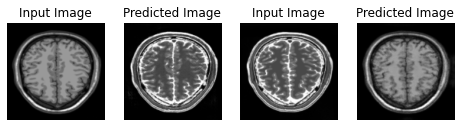

Saving checkpoint for epoch 109 at ./Trained_Model/ckpt-109


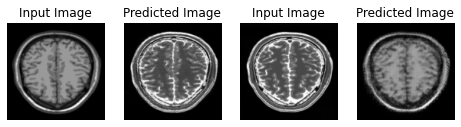

Saving checkpoint for epoch 110 at ./Trained_Model/ckpt-110


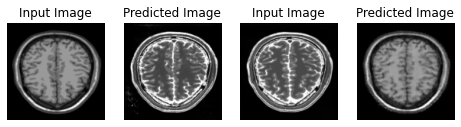

Saving checkpoint for epoch 111 at ./Trained_Model/ckpt-111


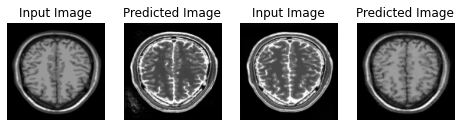

Saving checkpoint for epoch 112 at ./Trained_Model/ckpt-112


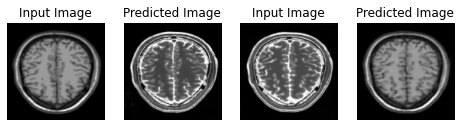

Saving checkpoint for epoch 113 at ./Trained_Model/ckpt-113


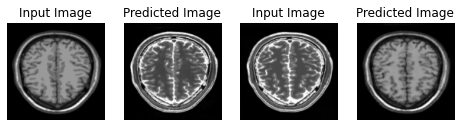

Saving checkpoint for epoch 114 at ./Trained_Model/ckpt-114


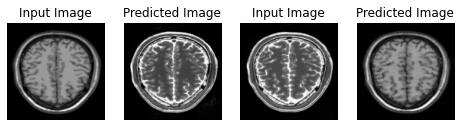

Saving checkpoint for epoch 115 at ./Trained_Model/ckpt-115


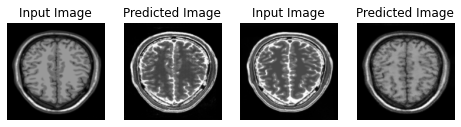

Saving checkpoint for epoch 116 at ./Trained_Model/ckpt-116


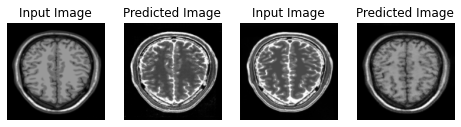

Saving checkpoint for epoch 117 at ./Trained_Model/ckpt-117


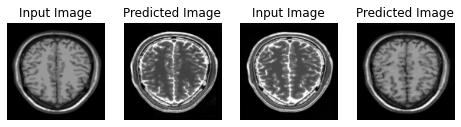

Saving checkpoint for epoch 118 at ./Trained_Model/ckpt-118


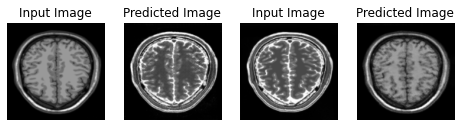

Saving checkpoint for epoch 119 at ./Trained_Model/ckpt-119


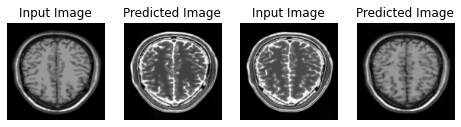

Saving checkpoint for epoch 120 at ./Trained_Model/ckpt-120


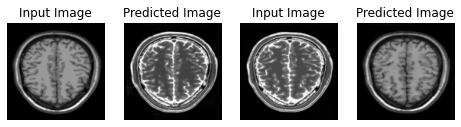

Saving checkpoint for epoch 121 at ./Trained_Model/ckpt-121


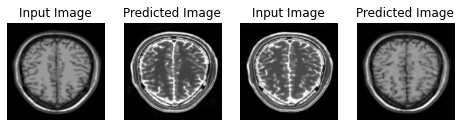

Saving checkpoint for epoch 122 at ./Trained_Model/ckpt-122


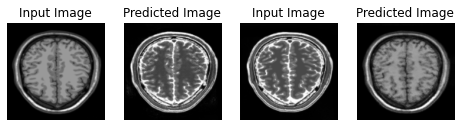

Saving checkpoint for epoch 123 at ./Trained_Model/ckpt-123


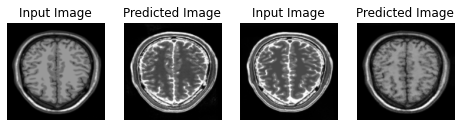

Saving checkpoint for epoch 124 at ./Trained_Model/ckpt-124


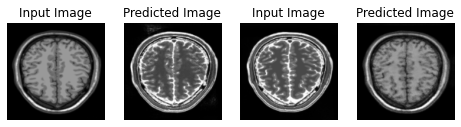

Saving checkpoint for epoch 125 at ./Trained_Model/ckpt-125


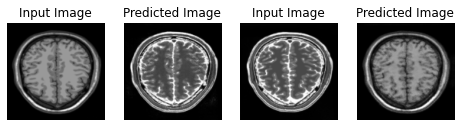

Saving checkpoint for epoch 126 at ./Trained_Model/ckpt-126


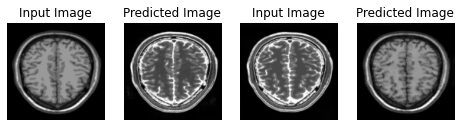

Saving checkpoint for epoch 127 at ./Trained_Model/ckpt-127


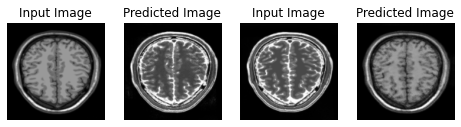

Saving checkpoint for epoch 128 at ./Trained_Model/ckpt-128


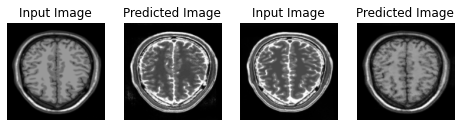

Saving checkpoint for epoch 129 at ./Trained_Model/ckpt-129


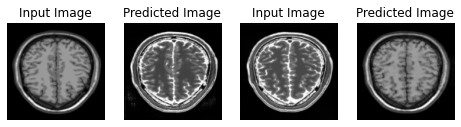

Saving checkpoint for epoch 130 at ./Trained_Model/ckpt-130


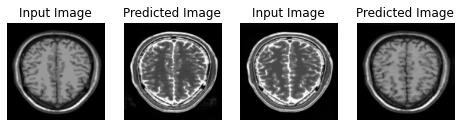

Saving checkpoint for epoch 131 at ./Trained_Model/ckpt-131


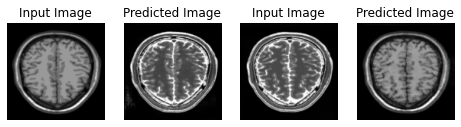

Saving checkpoint for epoch 132 at ./Trained_Model/ckpt-132


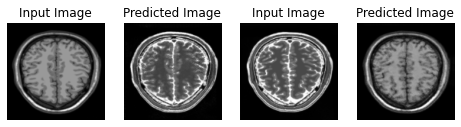

Saving checkpoint for epoch 133 at ./Trained_Model/ckpt-133


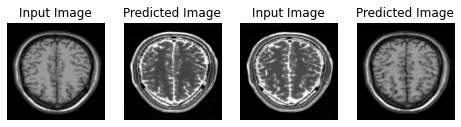

Saving checkpoint for epoch 134 at ./Trained_Model/ckpt-134


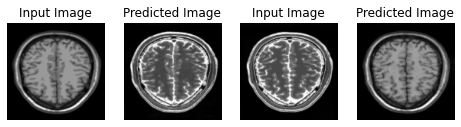

Saving checkpoint for epoch 135 at ./Trained_Model/ckpt-135


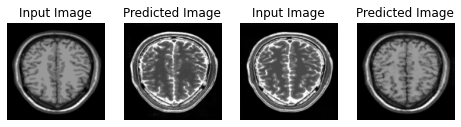

Saving checkpoint for epoch 136 at ./Trained_Model/ckpt-136


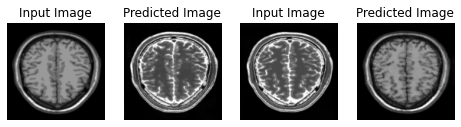

Saving checkpoint for epoch 137 at ./Trained_Model/ckpt-137


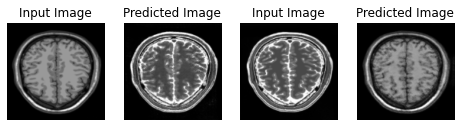

Saving checkpoint for epoch 138 at ./Trained_Model/ckpt-138


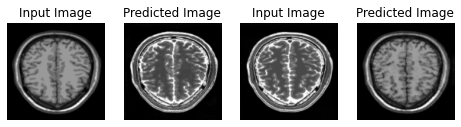

Saving checkpoint for epoch 139 at ./Trained_Model/ckpt-139


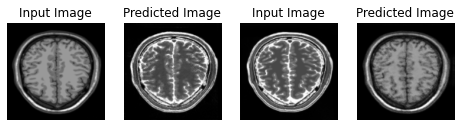

Saving checkpoint for epoch 140 at ./Trained_Model/ckpt-140


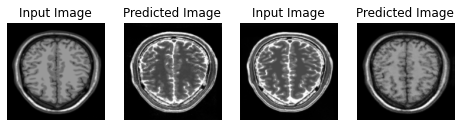

Saving checkpoint for epoch 141 at ./Trained_Model/ckpt-141


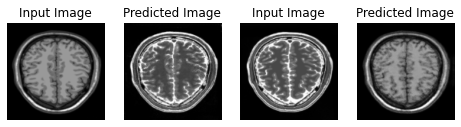

Saving checkpoint for epoch 142 at ./Trained_Model/ckpt-142


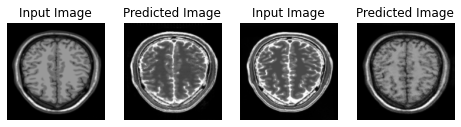

Saving checkpoint for epoch 143 at ./Trained_Model/ckpt-143


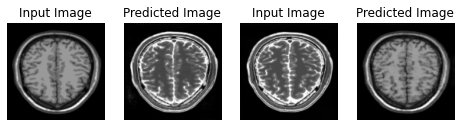

Saving checkpoint for epoch 144 at ./Trained_Model/ckpt-144


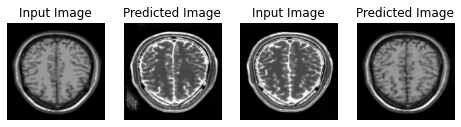

Saving checkpoint for epoch 145 at ./Trained_Model/ckpt-145


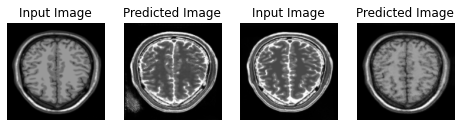

Saving checkpoint for epoch 146 at ./Trained_Model/ckpt-146


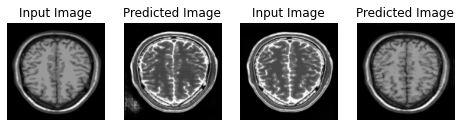

Saving checkpoint for epoch 147 at ./Trained_Model/ckpt-147


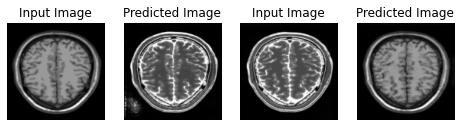

Saving checkpoint for epoch 148 at ./Trained_Model/ckpt-148


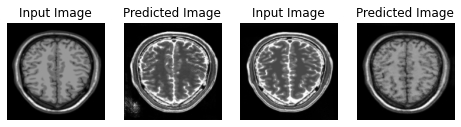

Saving checkpoint for epoch 149 at ./Trained_Model/ckpt-149


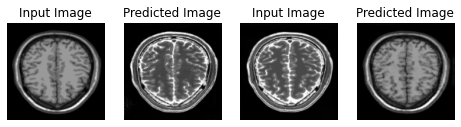

Saving checkpoint for epoch 150 at ./Trained_Model/ckpt-150


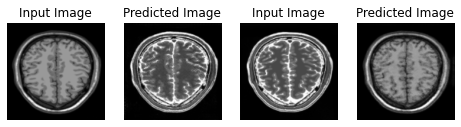

Saving checkpoint for epoch 151 at ./Trained_Model/ckpt-151


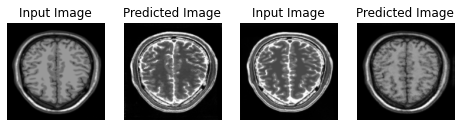

Saving checkpoint for epoch 152 at ./Trained_Model/ckpt-152


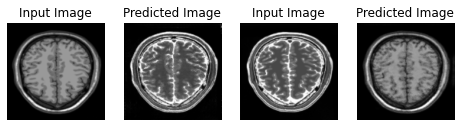

Saving checkpoint for epoch 153 at ./Trained_Model/ckpt-153


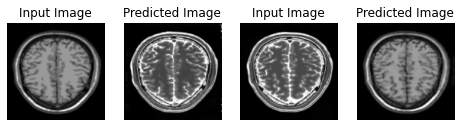

Saving checkpoint for epoch 154 at ./Trained_Model/ckpt-154


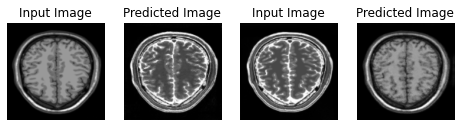

Saving checkpoint for epoch 155 at ./Trained_Model/ckpt-155


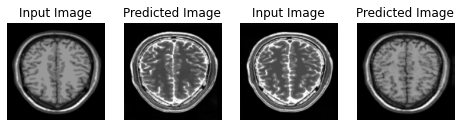

Saving checkpoint for epoch 156 at ./Trained_Model/ckpt-156


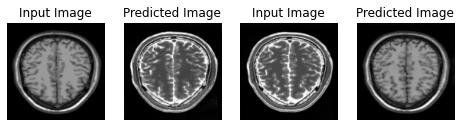

Saving checkpoint for epoch 157 at ./Trained_Model/ckpt-157


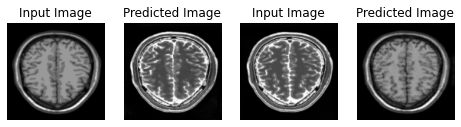

Saving checkpoint for epoch 158 at ./Trained_Model/ckpt-158


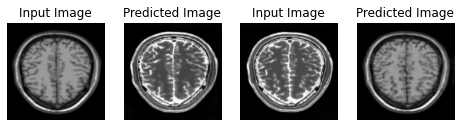

Saving checkpoint for epoch 159 at ./Trained_Model/ckpt-159


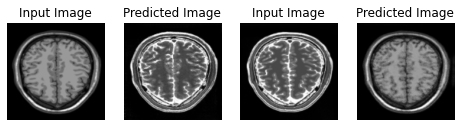

Saving checkpoint for epoch 160 at ./Trained_Model/ckpt-160


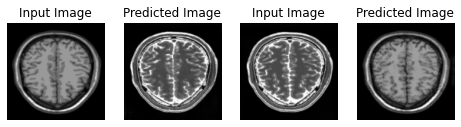

Saving checkpoint for epoch 161 at ./Trained_Model/ckpt-161


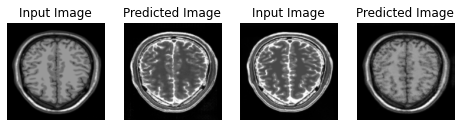

Saving checkpoint for epoch 162 at ./Trained_Model/ckpt-162


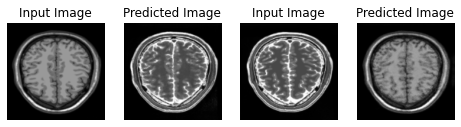

Saving checkpoint for epoch 163 at ./Trained_Model/ckpt-163


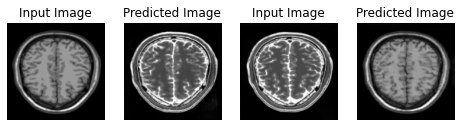

Saving checkpoint for epoch 164 at ./Trained_Model/ckpt-164


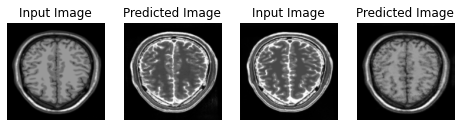

Saving checkpoint for epoch 165 at ./Trained_Model/ckpt-165


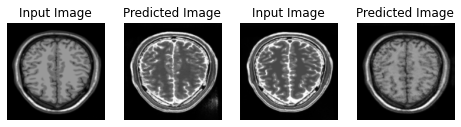

Saving checkpoint for epoch 166 at ./Trained_Model/ckpt-166


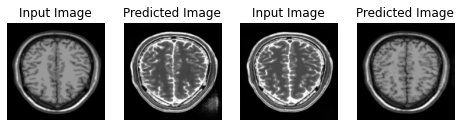

Saving checkpoint for epoch 167 at ./Trained_Model/ckpt-167


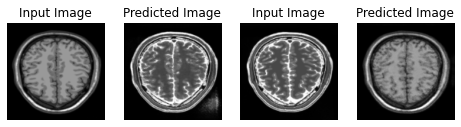

Saving checkpoint for epoch 168 at ./Trained_Model/ckpt-168


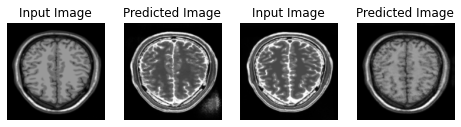

Saving checkpoint for epoch 169 at ./Trained_Model/ckpt-169


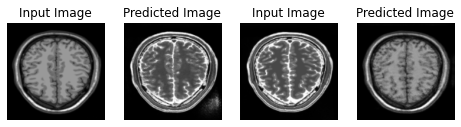

Saving checkpoint for epoch 170 at ./Trained_Model/ckpt-170


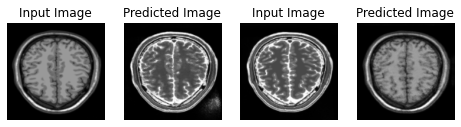

Saving checkpoint for epoch 171 at ./Trained_Model/ckpt-171


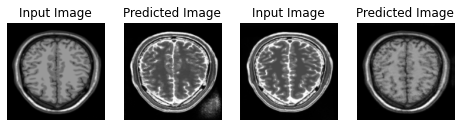

Saving checkpoint for epoch 172 at ./Trained_Model/ckpt-172


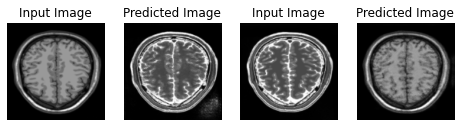

Saving checkpoint for epoch 173 at ./Trained_Model/ckpt-173


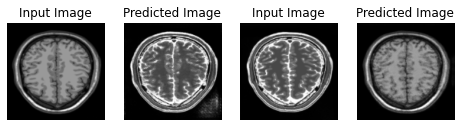

Saving checkpoint for epoch 174 at ./Trained_Model/ckpt-174


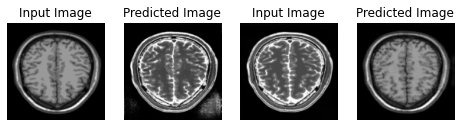

Saving checkpoint for epoch 175 at ./Trained_Model/ckpt-175


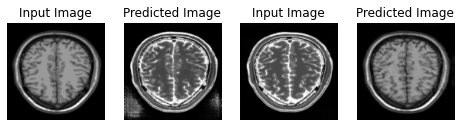

Saving checkpoint for epoch 176 at ./Trained_Model/ckpt-176


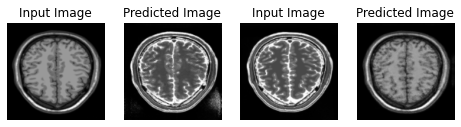

Saving checkpoint for epoch 177 at ./Trained_Model/ckpt-177


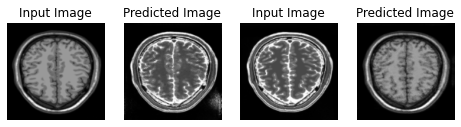

Saving checkpoint for epoch 178 at ./Trained_Model/ckpt-178


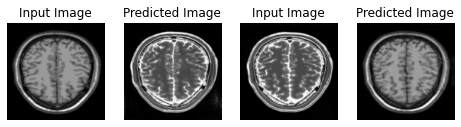

Saving checkpoint for epoch 179 at ./Trained_Model/ckpt-179


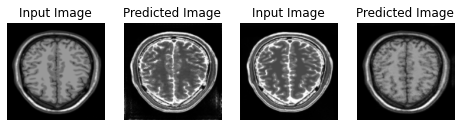

Saving checkpoint for epoch 180 at ./Trained_Model/ckpt-180


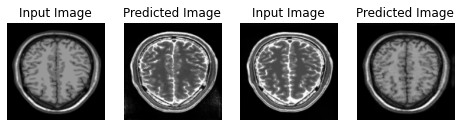

Saving checkpoint for epoch 181 at ./Trained_Model/ckpt-181


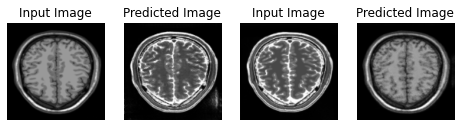

Saving checkpoint for epoch 182 at ./Trained_Model/ckpt-182


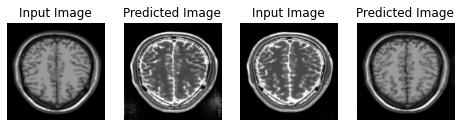

Saving checkpoint for epoch 183 at ./Trained_Model/ckpt-183


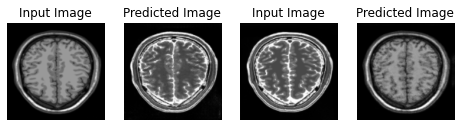

Saving checkpoint for epoch 184 at ./Trained_Model/ckpt-184


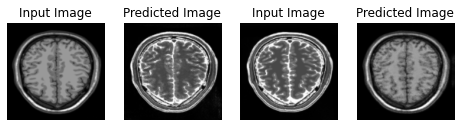

Saving checkpoint for epoch 185 at ./Trained_Model/ckpt-185


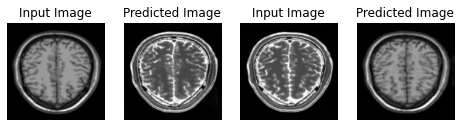

Saving checkpoint for epoch 186 at ./Trained_Model/ckpt-186


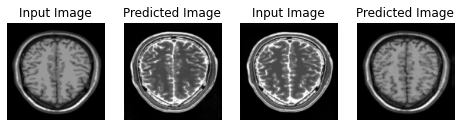

Saving checkpoint for epoch 187 at ./Trained_Model/ckpt-187


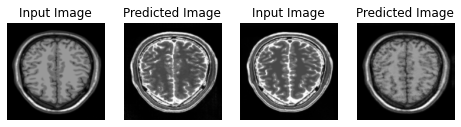

Saving checkpoint for epoch 188 at ./Trained_Model/ckpt-188


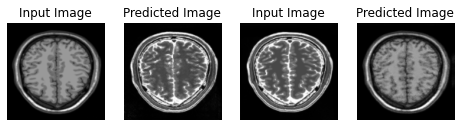

Saving checkpoint for epoch 189 at ./Trained_Model/ckpt-189


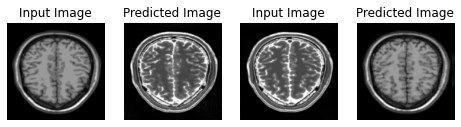

Saving checkpoint for epoch 190 at ./Trained_Model/ckpt-190


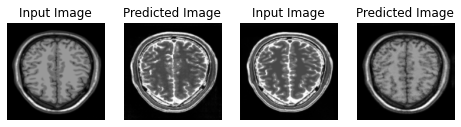

Saving checkpoint for epoch 191 at ./Trained_Model/ckpt-191


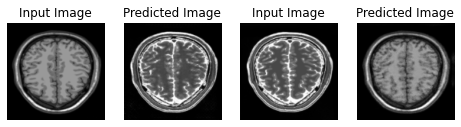

Saving checkpoint for epoch 192 at ./Trained_Model/ckpt-192


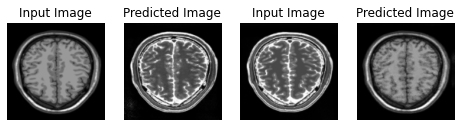

Saving checkpoint for epoch 193 at ./Trained_Model/ckpt-193


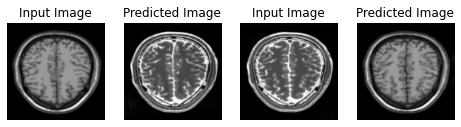

Saving checkpoint for epoch 194 at ./Trained_Model/ckpt-194


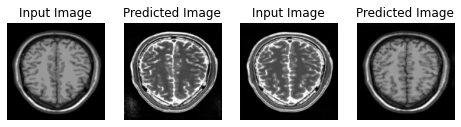

Saving checkpoint for epoch 195 at ./Trained_Model/ckpt-195


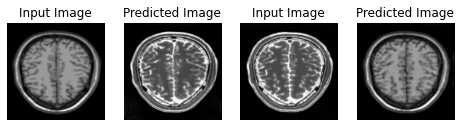

Saving checkpoint for epoch 196 at ./Trained_Model/ckpt-196


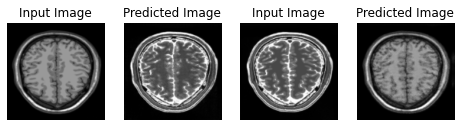

Saving checkpoint for epoch 197 at ./Trained_Model/ckpt-197


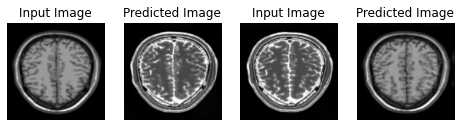

Saving checkpoint for epoch 198 at ./Trained_Model/ckpt-198


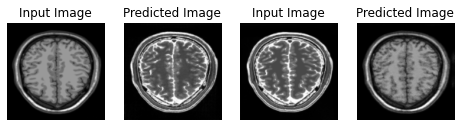

Saving checkpoint for epoch 199 at ./Trained_Model/ckpt-199


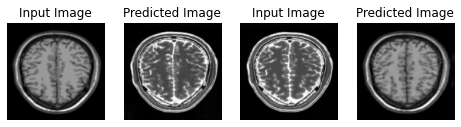

Saving checkpoint for epoch 200 at ./Trained_Model/ckpt-200


In [159]:
for epoch in range(1, EPOCHS+1):
    for image_x, image_y in tf.data.Dataset.zip((t1_data, t2_data)):
        train_step(image_x, image_y)
    generate_images(generator_g, sample_t1_data, generator_f, sample_t2_data)
    ckpt_save_path = ckpt_manager.save()
    print('Saving checkpoint for epoch', epoch, 'at', ckpt_save_path)

In [161]:
#creating gif of the training.
anim_file = 'cyclegan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)


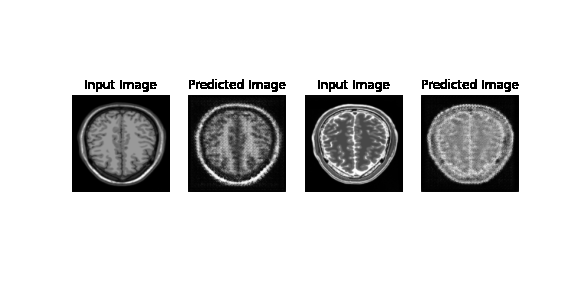

In [164]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)